In [10]:
import torch
import matplotlib
import pandas as pd

In [66]:
import os
from PIL import Image

def resize_images(input_dir, output_dir, target_size=(480, 480)):
    # Создаем выходную директорию если её нет
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
        
    # Проходим по всем поддиректориям
    for root, dirs, files in os.walk(input_dir):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg')):
                # Полный путь к файлу
                input_path = os.path.join(root, file)
                
                try:
                    # Открываем и изменяем размер изображения
                    with Image.open(input_path) as img:
                        img = img.resize(target_size, Image.Resampling.LANCZOS)
                        
                        # Сохраняем в выходную директорию
                        output_path = os.path.join(output_dir, file)
                        img.save(output_path)
                        
                except Exception as e:
                    print(f"Ошибка при обработке {file}: {str(e)}")

# Пример использования
input_directory = "images/images/train"  # Укажите путь к общей папке с изображениями
output_directory = "images/new_images"  # Укажите путь куда сохранять

resize_images(input_directory, output_directory)



KeyboardInterrupt: 

In [65]:
import shutil

def clear_directory(directory):
    try:
        # Удаляем все содержимое директории
        shutil.rmtree(directory)
        # Создаем директорию заново
        os.makedirs(directory)
        print(f"Директория {directory} успешно очищена")
    except Exception as e:
        print(f"Ошибка при очистке директории: {str(e)}")

# Очищаем входную директорию
clear_directory(output_directory)


Директория images/new_images успешно очищена


In [42]:
import pandas as pd

# Загрузка данных
df = pd.read_csv('E:\jupyter\Грибы\metadata\FungiTastic-FewShot\FungiTastic-FewShot-Train.csv')

# Выбор входных параметров X
X = df[['habitat', 'substrate', 'elevation', 'landcover', 'biogeographicalRegion']]

# Выбор выходных параметров y 
y = df[['category_id', 'kingdom', 'phylum', 'class']]

print("Размерность входных данных X:", X.shape)
print("Размерность выходных данных y:", y.shape)



Размерность входных данных X: (7819, 5)
Размерность выходных данных y: (7819, 4)


In [56]:
from sklearn.ensemble import RandomForestRegressor
import numpy as np

# Создаем копии данных для заполнения пропусков
X_temp = X.copy()

# Для каждого столбца с пропусками
for column in ['elevation', 'landcover']:
    
    # Создаем маску для непропущенных значений
    known_mask = X_temp[column].notna()
    
    # Создаем обучающий набор без пропущенных значений
    train_data = X_temp[known_mask].drop(column, axis=1)
    target = X_temp[known_mask][column]
    
    # Создаем и обучаем модель
    rf = RandomForestRegressor(n_estimators=100, random_state=42)
    rf.fit(train_data, target)
    
    # Предсказываем пропущенные значения
    missing_data = X_temp[~known_mask].drop(column, axis=1)
    predicted_values = rf.predict(missing_data)
    
    # Заполняем пропуски предсказанными значениями
    X.loc[~known_mask, column] = predicted_values

print("Пропуски успешно заполнены")


ValueError: Found array with 0 sample(s) (shape=(0, 4)) while a minimum of 1 is required by RandomForestRegressor.

In [43]:
from sklearn.preprocessing import LabelEncoder

# Создаем словарь для хранения энкодеров
encoders_x = {}
encoders_y = {}

# Токенизация текстовых признаков в X
for column in X.select_dtypes(include=['object']).columns:
    encoders_x[column] = LabelEncoder()
    X[column] = encoders_x[column].fit_transform(X[column].astype(str))

# Токенизация текстовых признаков в y 
for column in y.select_dtypes(include=['object']).columns:
    encoders_y[column] = LabelEncoder()
    y[column] = encoders_y[column].fit_transform(y[column].astype(str))

print("Токенизация завершена")
print("\nПример преобразованных данных X:")
print(X.head())
print("\nПример преобразованных данных y:")
print(y.head())


Токенизация завершена

Пример преобразованных данных X:
   habitat  substrate  elevation  landcover  biogeographicalRegion
0        4          6        0.0       16.0                      4
1       15          6        0.0       17.0                      4
2       15          6        0.0       17.0                      4
3       15          6        0.0       17.0                      4
4       15          6        0.0       17.0                      4

Пример преобразованных данных y:
   category_id  kingdom  phylum  class
0         2421        1       1     11
1          386        2       8     21
2          386        2       8     21
3          386        2       8     21
4          386        2       8     21


C:\Users\Артём\AppData\Local\Temp\ipykernel_280\3472274033.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[column] = encoders_x[column].fit_transform(X[column].astype(str))
C:\Users\Артём\AppData\Local\Temp\ipykernel_280\3472274033.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[column] = encoders_x[column].fit_transform(X[column].astype(str))
C:\Users\Артём\AppData\Local\Temp\ipykernel_280\3472274033.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

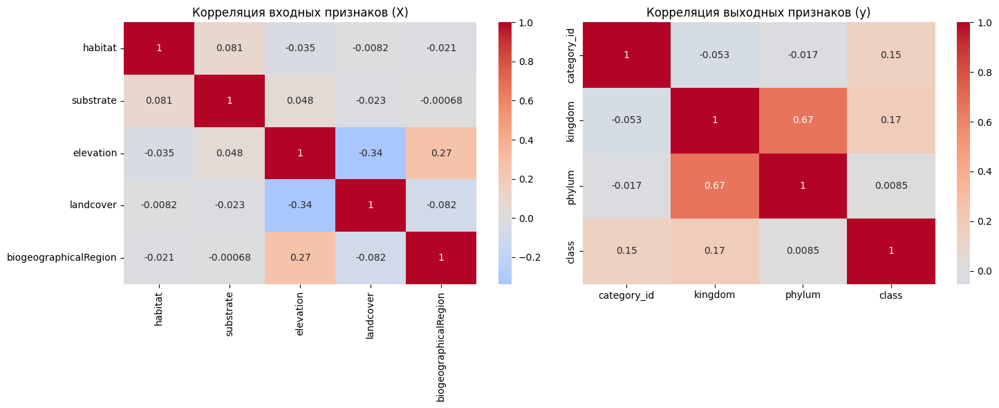

In [57]:
import seaborn as sns
import matplotlib.pyplot as plt

# Создаем фигуру с двумя подграфиками
plt.figure(figsize=(15, 6))

# Корреляционная карта для X
plt.subplot(1, 2, 1)
sns.heatmap(X.corr(), annot=True, cmap='coolwarm', center=0)
plt.title('Корреляция входных признаков (X)')

# Корреляционная карта для y

plt.subplot(1, 2, 2)
sns.heatmap(y.corr(), annot=True, cmap='coolwarm', center=0)
plt.title('Корреляция выходных признаков (y)')

plt.tight_layout()
plt.show()


In [58]:
from scipy import stats
import numpy as np

print("Анализ дисперсии (ANOVA):")
print("\nДля входных признаков (X):")

# ANOVA для X
for col in X.columns:
    groups = [group for _, group in X.groupby(col)[col]]
    f_stat, p_val = stats.f_oneway(*groups)
    print(f"\n{col}:")
    print(f"F-статистика: {f_stat:.4f}")
    print(f"p-значение: {p_val:.4f}")

print("\nДля выходных признаков (y):")

# ANOVA для y
for col in y.columns:
    groups = [group for _, group in y.groupby(col)[col]]
    f_stat, p_val = stats.f_oneway(*groups)
    print(f"\n{col}:")
    print(f"F-статистика: {f_stat:.4f}")  
    print(f"p-значение: {p_val:.4f}")


Анализ дисперсии (ANOVA):

Для входных признаков (X):

habitat:
F-статистика: inf
p-значение: 0.0000

substrate:
F-статистика: inf
p-значение: 0.0000

elevation:
F-статистика: inf
p-значение: 0.0000

landcover:
F-статистика: inf
p-значение: 0.0000

biogeographicalRegion:
F-статистика: inf
p-значение: 0.0000

Для выходных признаков (y):


c:\Users\Артём\AppData\Local\Programs\Python\Python310\lib\site-packages\scipy\stats\_axis_nan_policy.py:586: ConstantInputWarning: Each of the input arrays is constant; the F statistic is not defined or infinite
  res = hypotest_fun_out(*samples, **kwds)



category_id:
F-статистика: inf
p-значение: 0.0000

kingdom:
F-статистика: inf
p-значение: 0.0000

phylum:
F-статистика: inf
p-значение: 0.0000

class:
F-статистика: inf
p-значение: 0.0000


In [46]:
print("\nТест хи-квадрат:")
print("\nДля входных признаков (X):")

# Хи-квадрат для X
for col1 in X.columns:
    for col2 in X.columns:
        if col1 < col2:
            contingency = pd.crosstab(X[col1], X[col2])
            chi2, p_val, dof, expected = stats.chi2_contingency(contingency)
            print(f"\n{col1} vs {col2}:")
            print(f"Хи-квадрат: {chi2:.4f}")
            print(f"p-значение: {p_val:.4f}")

print("\nДля выходных признаков (y):")

# Хи-квадрат для y 
for col1 in y.columns:
    for col2 in y.columns:
        if col1 < col2:
            contingency = pd.crosstab(y[col1], y[col2])
            chi2, p_val, dof, expected = stats.chi2_contingency(contingency)
            print(f"\n{col1} vs {col2}:")
            print(f"Хи-квадрат: {chi2:.4f}")
            print(f"p-значение: {p_val:.4f}")



Тест хи-квадрат:

Для входных признаков (X):

habitat vs substrate:
Хи-квадрат: 9734.2151
p-значение: 0.0000

habitat vs landcover:
Хи-квадрат: 2469.8796
p-значение: 0.0000

elevation vs habitat:
Хи-квадрат: 28025.9032
p-значение: 0.0000

elevation vs substrate:
Хи-квадрат: 22902.6568
p-значение: 0.0000

elevation vs landcover:
Хи-квадрат: 31059.0704
p-значение: 0.0000

landcover vs substrate:
Хи-квадрат: 2078.2707
p-значение: 0.0000

biogeographicalRegion vs habitat:
Хи-квадрат: 3080.0597
p-значение: 0.0000

biogeographicalRegion vs substrate:
Хи-квадрат: 1744.0694
p-значение: 0.0000

biogeographicalRegion vs elevation:
Хи-квадрат: 21942.2754
p-значение: 0.0000

biogeographicalRegion vs landcover:
Хи-квадрат: 11473.1669
p-значение: 0.0000

Для выходных признаков (y):

category_id vs kingdom:
Хи-квадрат: 15638.0000
p-значение: 0.0000

category_id vs phylum:
Хи-квадрат: 78190.0000
p-значение: 0.0000

category_id vs class:
Хи-квадрат: 250208.0000
p-значение: 0.0000

kingdom vs phylum:
Х

In [47]:
from sklearn.feature_selection import VarianceThreshold
print("\nПроверка дисперсии признаков (Variance Threshold):")

# Для входных признаков (X)
selector_x = VarianceThreshold()
X_var = selector_x.fit_transform(X)
selected_features_x = X.columns[selector_x.get_support()].tolist()

print("\nДля входных признаков (X):")
print(f"Исходное количество признаков: {X.shape[1]}")
print(f"Количество признаков после отбора: {X_var.shape[1]}")
print("Отобранные признаки:", selected_features_x)

# Для выходных признаков (y)
selector_y = VarianceThreshold()
y_var = selector_y.fit_transform(y)
selected_features_y = y.columns[selector_y.get_support()].tolist()

print("\nДля выходных признаков (y):")

print(f"Исходное количество признаков: {y.shape[1]}")
print(f"Количество признаков после отбора: {y_var.shape[1]}")
print("Отобранные признаки:", selected_features_y)



Проверка дисперсии признаков (Variance Threshold):

Для входных признаков (X):
Исходное количество признаков: 5
Количество признаков после отбора: 5
Отобранные признаки: ['habitat', 'substrate', 'elevation', 'landcover', 'biogeographicalRegion']

Для выходных признаков (y):
Исходное количество признаков: 4
Количество признаков после отбора: 4
Отобранные признаки: ['category_id', 'kingdom', 'phylum', 'class']


In [48]:
print("\nПроверка на выбросы:")

# Для входных признаков (X)
print("\nДля входных признаков (X):")
for column in X.columns:
    Q1 = X[column].quantile(0.25)
    Q3 = X[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = X[(X[column] < lower_bound) | (X[column] > upper_bound)][column]
    if len(outliers) > 0:
        print(f"\nВыбросы в признаке {column}:")
        print(f"Количество выбросов: {len(outliers)}")
        print(f"Процент выбросов: {(len(outliers)/len(X[column])*100):.2f}%")
        print(f"Нижняя граница: {lower_bound:.2f}")
        print(f"Верхняя граница: {upper_bound:.2f}")

# Для выходных признаков (y)
print("\nДля выходных признаков (y):")
for column in y.columns:
    Q1 = y[column].quantile(0.25)
    Q3 = y[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = y[(y[column] < lower_bound) | (y[column] > upper_bound)][column]
    if len(outliers) > 0:
        print(f"\nВыбросы в признаке {column}:")
        print(f"Количество выбросов: {len(outliers)}")
        print(f"Процент выбросов: {(len(outliers)/len(y[column])*100):.2f}%")
        print(f"Нижняя граница: {lower_bound:.2f}")
        print(f"Верхняя граница: {upper_bound:.2f}")



Проверка на выбросы:

Для входных признаков (X):

Выбросы в признаке elevation:
Количество выбросов: 649
Процент выбросов: 8.30%
Нижняя граница: -102.00
Верхняя граница: 170.00

Выбросы в признаке biogeographicalRegion:
Количество выбросов: 1309
Процент выбросов: 16.74%
Нижняя граница: 4.00
Верхняя граница: 4.00

Для выходных признаков (y):

Выбросы в признаке kingdom:
Количество выбросов: 441
Процент выбросов: 5.64%
Нижняя граница: 1.00
Верхняя граница: 1.00

Выбросы в признаке phylum:
Количество выбросов: 485
Процент выбросов: 6.20%
Нижняя граница: -0.50
Верхняя граница: 3.50


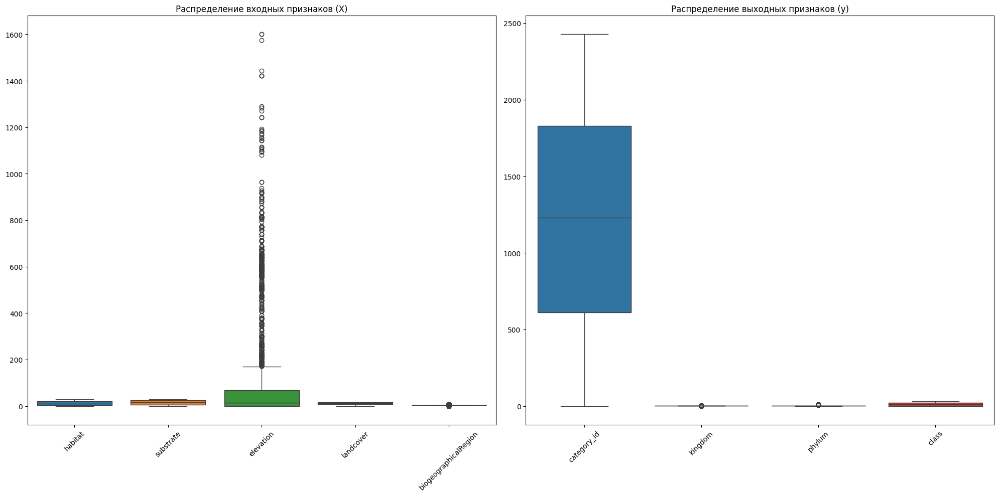

In [49]:
import matplotlib.pyplot as plt
import seaborn as sns

# Настройка размера графиков
plt.figure(figsize=(20, 10))

# Построение боксплотов для входных признаков
plt.subplot(1, 2, 1)
sns.boxplot(data=X)
plt.title('Распределение входных признаков (X)')
plt.xticks(rotation=45)

# Построение боксплотов для выходных признаков  
plt.subplot(1, 2, 2)
sns.boxplot(data=y)
plt.title('Распределение выходных признаков (y)')
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


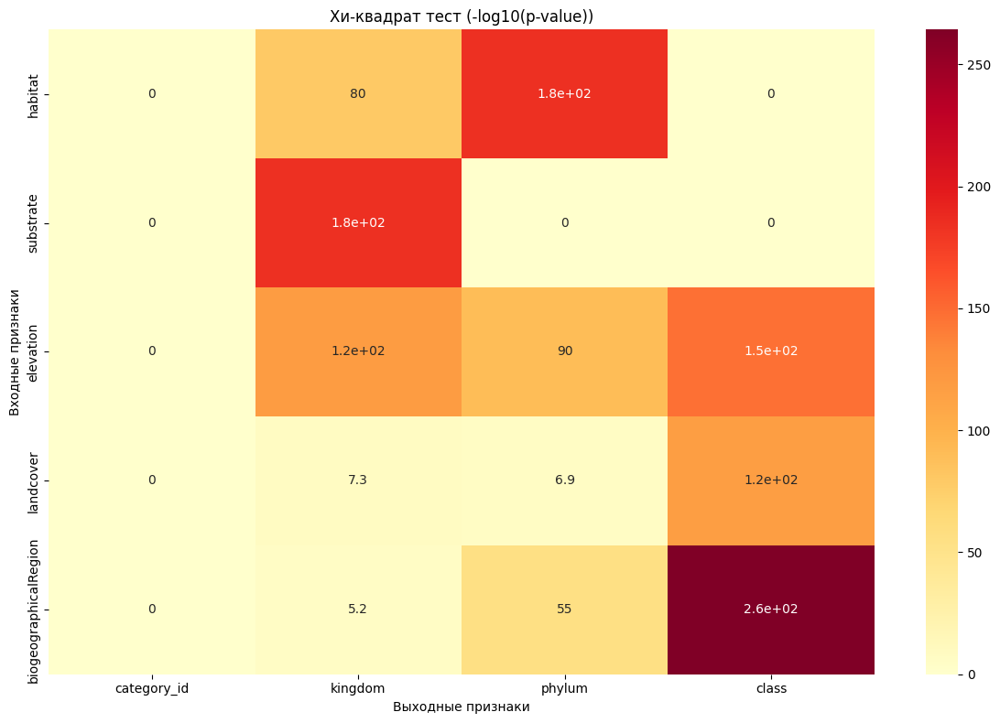

In [59]:
import numpy as np
from scipy.stats import chi2_contingency
import seaborn as sns
import matplotlib.pyplot as plt

# Создаем матрицу для хранения p-значений
chi_square_matrix = np.zeros((len(X.columns), len(y.columns)))

# Вычисляем хи-квадрат тест для каждой пары признаков
for i, x_col in enumerate(X.columns):
    for j, y_col in enumerate(y.columns):
        contingency = pd.crosstab(X[x_col], y[y_col])
        chi2, p_value, _, _ = chi2_contingency(contingency)
        chi_square_matrix[i,j] = -np.log10(p_value) if p_value > 0 else 0

# Создаем тепловую карту
plt.figure(figsize=(12, 8))
sns.heatmap(chi_square_matrix, 
            xticklabels=y.columns,
            yticklabels=X.columns,
            cmap='YlOrRd',
            annot=True)

plt.title('Хи-квадрат тест (-log10(p-value))')
plt.xlabel('Выходные признаки')
plt.ylabel('Входные признаки')
plt.tight_layout()
plt.show()


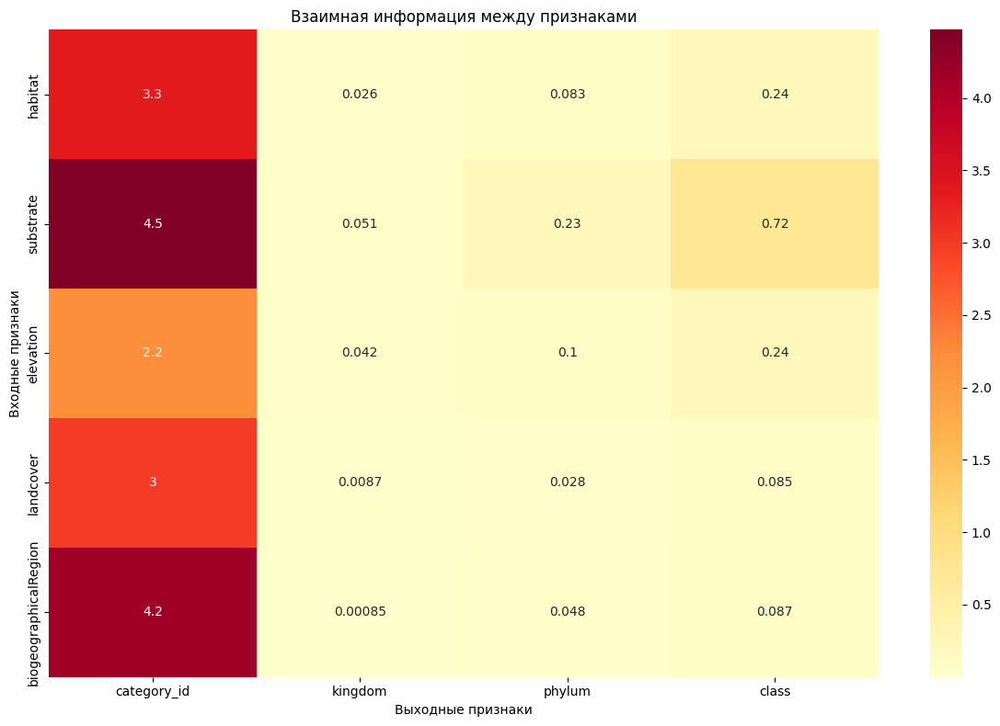

In [60]:
from sklearn.feature_selection import mutual_info_classif
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Создаем матрицу для хранения значений взаимной информации
mi_matrix = np.zeros((len(X.columns), len(y.columns)))

# Вычисляем взаимную информацию для каждой пары признаков
for j, y_col in enumerate(y.columns):
    mi_scores = mutual_info_classif(X, y[y_col])
    mi_matrix[:,j] = mi_scores

# Создаем тепловую карту
plt.figure(figsize=(12, 8))
sns.heatmap(mi_matrix,
            xticklabels=y.columns, 
            yticklabels=X.columns,
            cmap='YlOrRd',
            annot=True)

plt.title('Взаимная информация между признаками')
plt.xlabel('Выходные признаки')
plt.ylabel('Входные признаки')
plt.tight_layout()
plt.show()


In [61]:
# Проверяем наличие пустых значений в X и y
print("Количество пустых значений в X:")
print(X.isnull().sum())
print("\nКоличество пустых значений в y:")
print(y.isnull().sum())

# Общее количество пустых значений
print(f"\nОбщее количество пустых значений в X: {X.isnull().sum().sum()}")
print(f"Общее количество пустых значений в y: {y.isnull().sum().sum()}")


Количество пустых значений в X:
habitat                  0
substrate                0
elevation                0
landcover                0
biogeographicalRegion    0
dtype: int64

Количество пустых значений в y:
category_id    0
kingdom        0
phylum         0
class          0
dtype: int64

Общее количество пустых значений в X: 0
Общее количество пустых значений в y: 0


In [64]:
# Выводим количество уникальных значений для каждого признака в X
print("Количество уникальных значений в признаках X:")
for col in X.columns:
    n_unique = X[col].nunique()
    print(f"{col}: {n_unique} ({n_unique/len(X)*100:.1f}%)")

print("\nКоличество уникальных значений в признаках y:")
for col in y.columns:
    n_unique = y[col].nunique() 
    print(f"{col}: {n_unique} ({n_unique/len(y)*100:.1f}%)")

# Выводим количество каждого уникального значения в признаках X
print("\nРаспределение значений в признаках X:")
for col in X.columns:
    print(f"\n{col}:")
    value_counts = X[col].value_counts()
    for value, count in value_counts.items():
        print(f"{value}: {count} ({count/len(X)*100:.1f}%)")

print("\nРаспределение значений в признаках y:")
for col in y.columns:
    print(f"\n{col}:")
    value_counts = y[col].value_counts()
    for value, count in value_counts.items():
        print(f"{value}: {count} ({count/len(y)*100:.1f}%)")


Количество уникальных значений в признаках X:
habitat: 31 (0.4%)
substrate: 31 (0.4%)
elevation: 409 (5.2%)
landcover: 37 (0.5%)
biogeographicalRegion: 8 (0.1%)

Количество уникальных значений в признаках y:
category_id: 2427 (31.0%)
kingdom: 3 (0.0%)
phylum: 11 (0.1%)
class: 33 (0.4%)

Распределение значений в признаках X:

habitat:
2: 1274 (16.3%)
4: 846 (10.8%)
10: 657 (8.4%)
23: 607 (7.8%)
7: 599 (7.7%)
25: 507 (6.5%)
15: 329 (4.2%)
5: 283 (3.6%)
9: 279 (3.6%)
1: 268 (3.4%)
12: 213 (2.7%)
24: 208 (2.7%)
17: 197 (2.5%)
26: 197 (2.5%)
3: 184 (2.4%)
6: 174 (2.2%)
8: 172 (2.2%)
16: 149 (1.9%)
29: 114 (1.5%)
22: 107 (1.4%)
18: 106 (1.4%)
30: 105 (1.3%)
0: 49 (0.6%)
27: 49 (0.6%)
21: 39 (0.5%)
20: 35 (0.4%)
13: 30 (0.4%)
19: 17 (0.2%)
11: 12 (0.2%)
28: 8 (0.1%)
14: 5 (0.1%)

substrate:
25: 2269 (29.0%)
6: 1449 (18.5%)
16: 692 (8.9%)
27: 456 (5.8%)
12: 400 (5.1%)
20: 399 (5.1%)
0: 319 (4.1%)
7: 292 (3.7%)
5: 216 (2.8%)
18: 195 (2.5%)
10: 186 (2.4%)
9: 107 (1.4%)
13: 92 (1.2%)
24: 82 (1.0%


ObservationID: 3052832307
Количество фотографий: 1


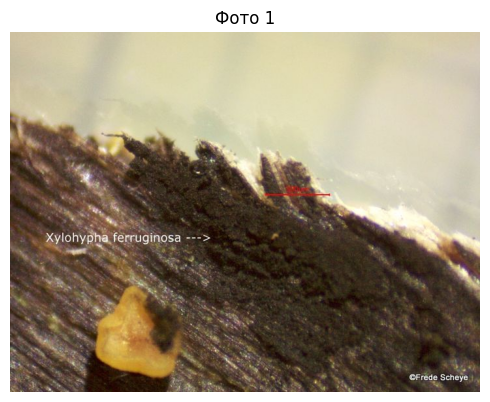

--------------------------------------------------

ObservationID: 3061954303
Количество фотографий: 10


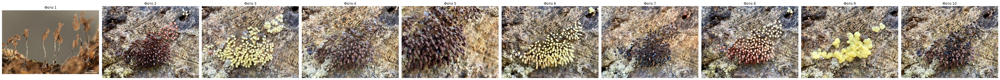

--------------------------------------------------

ObservationID: 3052910309
Количество фотографий: 1


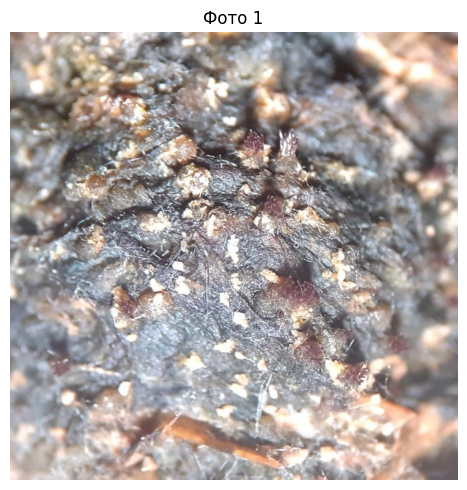

--------------------------------------------------

ObservationID: 3061954319
Количество фотографий: 2


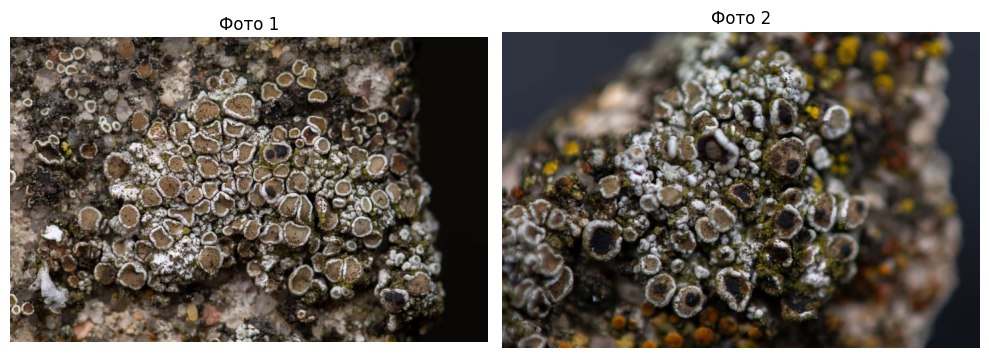

--------------------------------------------------

ObservationID: 3382566304
Количество фотографий: 2


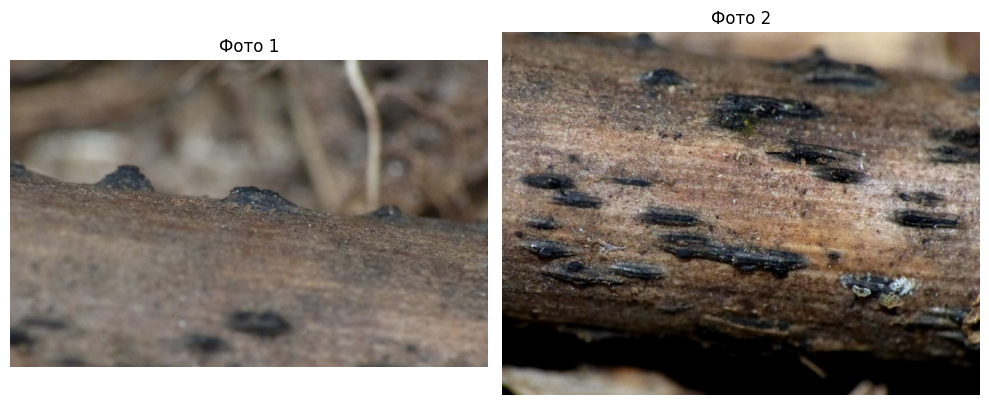

--------------------------------------------------

ObservationID: 3070932358
Количество фотографий: 1


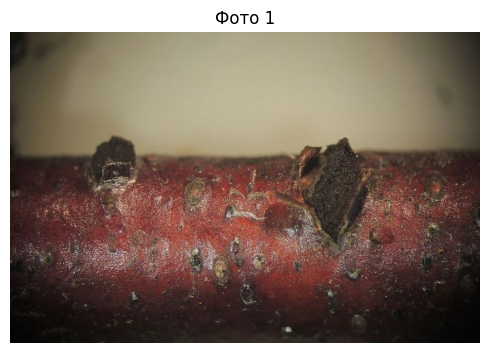

--------------------------------------------------

ObservationID: 3962112306
Количество фотографий: 5


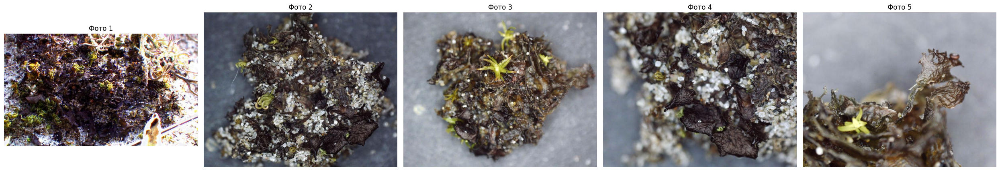

--------------------------------------------------

ObservationID: 3091021310
Количество фотографий: 2


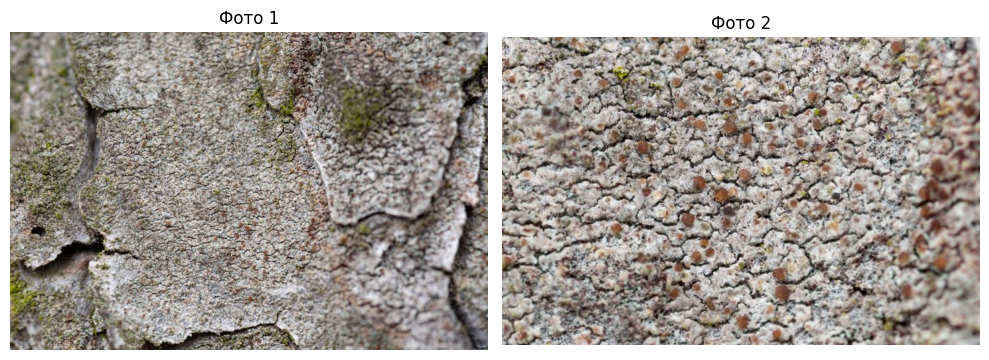

--------------------------------------------------

ObservationID: 3091007318
Количество фотографий: 1


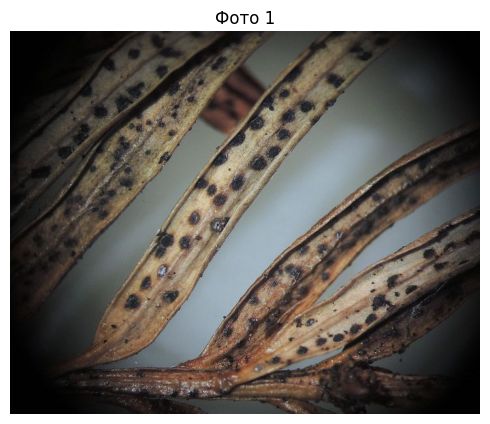

--------------------------------------------------

ObservationID: 3091021336
Количество фотографий: 2


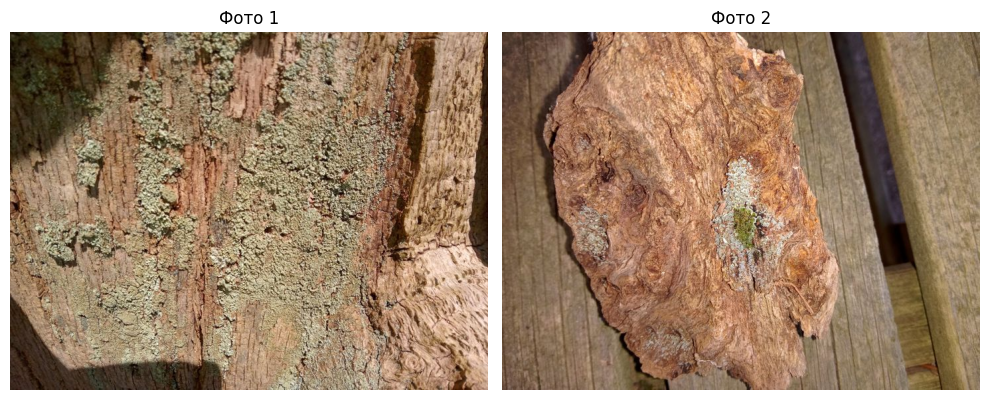

--------------------------------------------------

Фотографии для category_id: 2383
Количество фотографий: 30


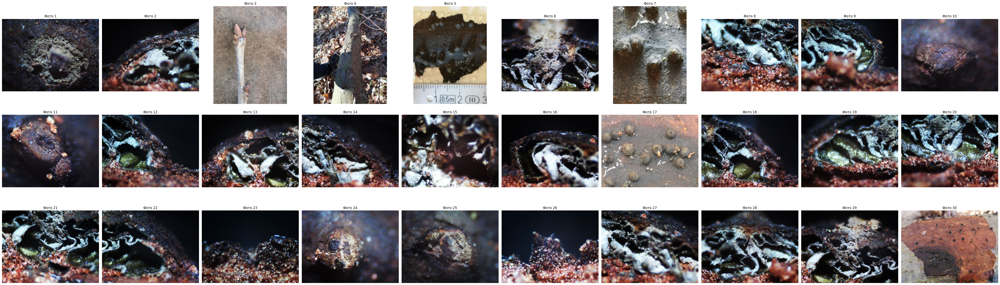

--------------------------------------------------


In [73]:
import os
from PIL import Image
import matplotlib.pyplot as plt

# Путь к папке с изображениями
image_dir = r"E:/jupyter/Грибы/images/images/train/720p"

# Получаем 10 случайных уникальных observationID
unique_ids = df['observationID'].unique()[:10]

# Для каждого ID показываем связанные фотографии
for obs_id in unique_ids:
    # Получаем все filename для данного observationID
    filenames = df[df['observationID'] == obs_id]['filename'].values
    
    print(f"\nObservationID: {obs_id}")
    print(f"Количество фотографий: {len(filenames)}")
    
    # Создаем подграфики для всех фото этого ID
    n_images = len(filenames)
    if n_images > 0:
        fig, axes = plt.subplots(1, n_images, figsize=(5*n_images, 5))
        if n_images == 1:
            axes = [axes]
            
        for idx, (ax, fname) in enumerate(zip(axes, filenames)):
            try:
                img_path = os.path.join(image_dir, fname)
                img = Image.open(img_path)
                ax.imshow(img)
                ax.axis('off')
                ax.set_title(f"Фото {idx+1}")
            except Exception as e:
                print(f"Ошибка при загрузке {fname}: {str(e)}")
                
        plt.tight_layout()
        plt.show()
    print("-" * 50)
    
# Показываем все фотографии для category_id = 2383
target_id = 2383
target_filenames = df[df['category_id'] == target_id]['filename'].values

print(f"\nФотографии для category_id: {target_id}")
print(f"Количество фотографий: {len(target_filenames)}")

if len(target_filenames) > 0:
    # Вычисляем количество строк и столбцов для сетки 3xN
    n_rows = 3
    n_cols = (len(target_filenames) + n_rows - 1) // n_rows  # Округление вверх
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(5*n_cols, 5*n_rows))
    axes = axes.flatten()
    
    for idx, fname in enumerate(target_filenames):
        try:
            img_path = os.path.join(image_dir, fname)
            img = Image.open(img_path)
            axes[idx].imshow(img)
            axes[idx].axis('off')
            axes[idx].set_title(f"Фото {idx+1}")
        except Exception as e:
            print(f"Ошибка при загрузке {fname}: {str(e)}")
    
    # Скрываем пустые оси
    for idx in range(len(target_filenames), len(axes)):
        axes[idx].axis('off')
            
    plt.tight_layout()
    plt.show()
print("-" * 50)



Фотографии для каждого уникального kingdom:

Kingdom: Fungi
Количество фотографий: 3


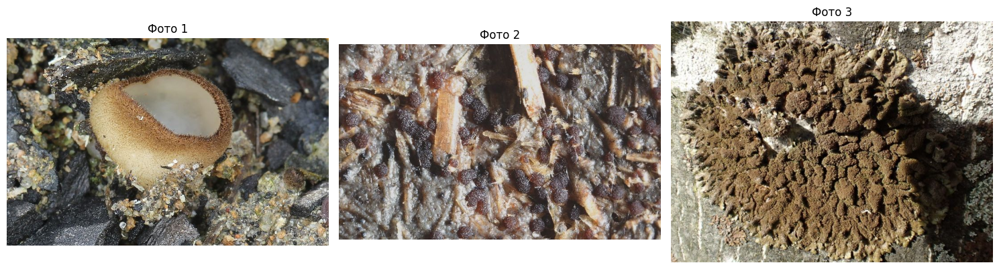

--------------------------------------------------

Kingdom: Protozoa
Количество фотографий: 3


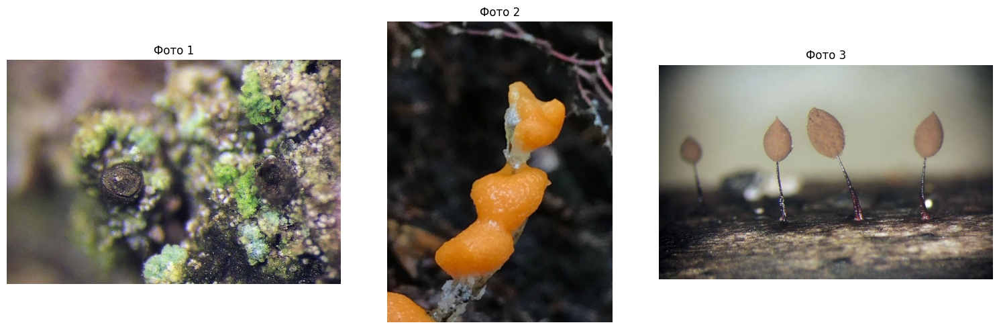

--------------------------------------------------

Kingdom: Chromista
Количество фотографий: 3


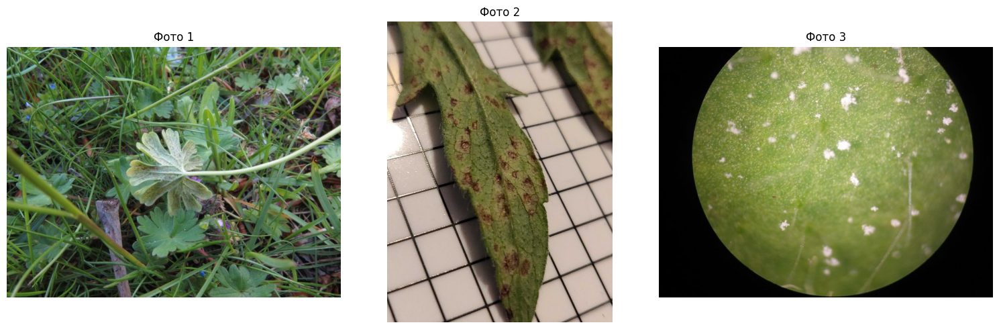

--------------------------------------------------


In [74]:
# Получаем уникальные значения kingdom
unique_kingdoms = df['kingdom'].unique()

print("\nФотографии для каждого уникального kingdom:")
for kingdom in unique_kingdoms:
    # Получаем 3 случайных файла для текущего kingdom
    kingdom_files = df[df['kingdom'] == kingdom]['filename'].values
    selected_files = np.random.choice(kingdom_files, min(3, len(kingdom_files)), replace=False)
    
    print(f"\nKingdom: {kingdom}")
    print(f"Количество фотографий: {len(selected_files)}")
    
    if len(selected_files) > 0:
        # Создаем сетку 1x3
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))
        axes = axes.flatten()
        
        for idx, fname in enumerate(selected_files):
            try:
                img_path = os.path.join(image_dir, fname)
                img = Image.open(img_path)
                axes[idx].imshow(img)
                axes[idx].axis('off')
                axes[idx].set_title(f"Фото {idx+1}")
            except Exception as e:
                print(f"Ошибка при загрузке {fname}: {str(e)}")
        
        # Скрываем пустые оси
        for idx in range(len(selected_files), len(axes)):
            axes[idx].axis('off')
                
        plt.tight_layout()
        plt.show()
    print("-" * 50)
